# QuDiPy tutorial: using the charge stability module

This tutorial will show how to use the charge stability module to generate a charge stability diagram using the constant interaction model and then perform the Hough transformation.

This tutorial will be updated to include the generation of the charge stability diagrams using the Hubbard model and also the extraction of parameters from the Hough transformation.


## 1. Add the current location to path
In order for this tutorial to work, you will need to run this from the tutorials folder.

In [9]:
import os, sys
sys.path.append(os.path.dirname(os.getcwd()))

## 2. Import the relevant modules

In [10]:
#From module
import qudipy.chargestability.csd_gen as gen
import qudipy.chargestability.csd_analysis as an
#For data maniupulation
import numpy as np
import pandas as pd
#For plotting
import seaborn as sb
import matplotlib.pyplot as plt

## 3. Specify the capacitance of the system you wish to simulate and then initialize the charge stability diagram object

In [11]:
# Dot capacitances
c_l = 51 * 10**-18
c_r = 50 * 10**-18
c_m = 5 * 10**-18
# Dot-to-gate capacitances
c_g1 = 1 * 10**-18
c_g2 = 1 * 10**-18
# Initialize Object
csd = gen.CSD(c_l, c_r, c_m, c_g1, c_g2)

## 4. Generate the charge stability diagram and then plot the resulting diagram
If you do not want to plot the figure, then simply run the first line of the following block and not the subsequent ones

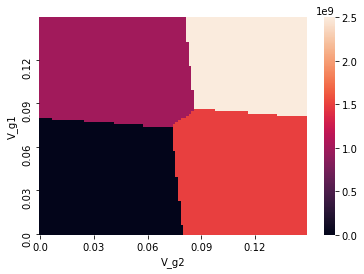

In [12]:
# Generate charge stability diagram
num=100
csd.generate_csd(0.15, 0.15, 1, 1.5, num=num)
# Plot using seaborn
p = sb.heatmap(csd.csd, cbar=True, xticklabels=int(num/5), yticklabels=int(num/5))
p.axes.invert_yaxis()
plt.show()

## 5. Find the edges of the charge stability diagram
In order for the Hough transform to be used, we need to have a bitmap of where edges are and aren't in the image. So, we need to run some pre-processing to first find the edges, and then transform that map of edges into a bitmap.

In order to find the edges, we can take the derivative of the above charge stability diagram. This is done automatically when csd.generate_csd() is called, and is stored in csd.csd_der.

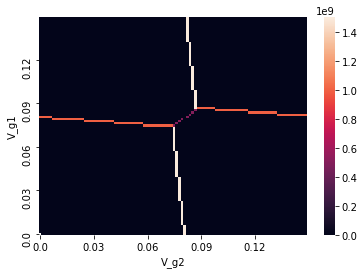

In [13]:
q = sb.heatmap(csd.csd_der, cbar=True, xticklabels=int(num/5), yticklabels=int(num/5))
q.axes.invert_yaxis()
plt.show()

## 6. Create bitmap from edge data
From that image, we can create a bitmap.

Note that in an actual experiment, the data won't be so clean, so there will be some aditional noise. Fortunately the Hough transform is relatively robust to random noise, but a more quantitative assessement is necessary before deployement. In addition, there is a threshold parameter in the bitmap generation function that allows any noise below a certain level to be ignored, which can help clean up some data as well.

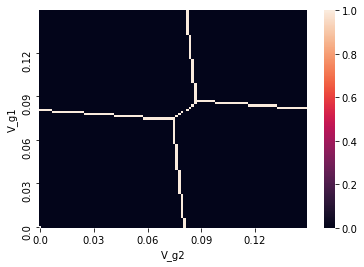

In [14]:
# Generate analysis object, and then use it to generate the bitmap
csd_an = an.CSDAnalysis(csd.csd_der)
csd_an.generate_bitmap(0.1)

r = sb.heatmap(csd_an.csd_bitmap, cbar=True, xticklabels=int(num/5), yticklabels=int(num/5))
r.axes.invert_yaxis()
plt.show()

Not that the data is now either 0 or 1 for each pixel, which can be seen by the colorbar on the righthand side.

## 7. Perform the Hough transform



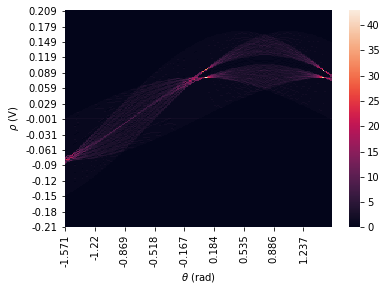

In [15]:
# Actual function
accumulator, thetas, rhos = csd_an.hough_transform()

# Round ranges to not clutter the plotting area to much
rhos = np.round(rhos, 3)
thetas = np.round(thetas, 3)

# Create pandas DataFrame for easy of plotting, then plot
df = pd.DataFrame(accumulator, index=rhos, columns=thetas)
s = sb.heatmap(df, cbar=True, xticklabels=int(num/5), yticklabels=int(num/5))
s.axes.invert_yaxis()
s.axes.set_xlabel(r'$\theta$ (rad)')
s.axes.set_ylabel(r'$\rho$ (V)')
plt.show()

The spots where the counts in the color bar are the highest places where lines fit the best. We can see that there are 4 peaks that roughly make a rectangle in the upper right hand side of the graph. We can convert from these polar coordiantes to the normal slope and intercept using $m = \frac{-\text{cos}(\theta)}{\text{sin}(\theta)}$ and $b = \frac{\rho}{\text{sin}(\theta)}$.

## 8. Discussion

Ideally at this point, we could pick the 4 largest peaks in the four different corners of the rectangle and plot those lines over the initial charge stability diagram. However for technical reasons this is a bit trick and has not been  implemented yet (but is the next on the agenda). The following code is a bit of a temporary work around to show that the Hough transform does seem to give reasonable slop and intercept parameters.

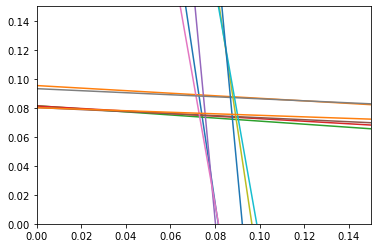

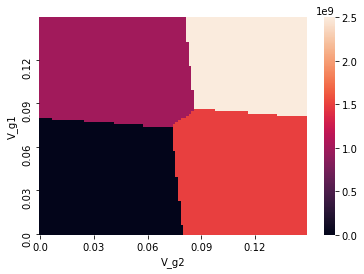

In [16]:
# Use with caution. This is a temporary proof of concept workaround
rho_list = []
theta_list = []
n=12
for i in range(n):
    ind = np.unravel_index(accumulator.argmax(), accumulator.shape)
    rho_list.append(rhos[ind[0]])
    theta_list.append(thetas[ind[1]])
    accumulator[ind[0]][ind[1]] = 0

for i in range(n):
    theta = theta_list[i]
    rho = rho_list[i]

    m = -np.cos(theta)/np.sin(theta)
    b = rho/np.sin(theta)

    x = np.linspace(0,1)
    y = m*x+b
    plt.plot(x,y)

plt.xlim(0, 0.15)
plt.ylim(0, 0.15)
plt.show()

p = sb.heatmap(csd.csd, cbar=True, xticklabels=int(num/5), yticklabels=int(num/5))
p.axes.invert_yaxis()

plt.show()



As we can see there it seems to fit fairly well to the 4 longest separating the (0,0)-(0,1), (0,0)-(1,0), (1,0)-(1,1) and (0,1)-(1,1) charge transitions. However, it does not really pick up the (0,1)-(1,0) charge transition. This is a consequence of the fact that this line is significantly shorter than the other charge transitions. Zooming in on that region, we can pick up that charge transition most strongly.

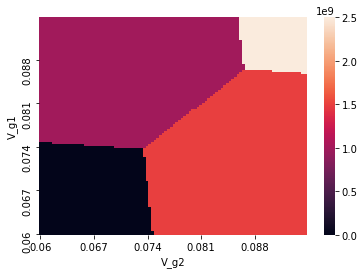

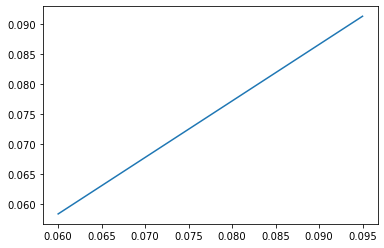

In [23]:
# Everyhting in the most condensed way possible, not showing plots of intermediate steps intermediate
csd.generate_csd(0.095, 0.095, 1, 1.5, num=num, v_g1_min=0.06, v_g2_min=0.06)

t = sb.heatmap(csd.csd, cbar=True, xticklabels=int(num/5), yticklabels=int(num/5))
t.axes.invert_yaxis()
plt.show()

csd_an = an.CSDAnalysis(csd.csd_der)
csd_an.generate_bitmap(0.1)

accumulator, thetas, rhos = csd_an.hough_transform()
ind = np.unravel_index(accumulator.argmax(), accumulator.shape)
rho_max = rhos[ind[0]]
theta_max = thetas[ind[1]]
m = -np.cos(theta_max)/np.sin(theta_max)
b = rho_max/np.sin(theta_max)

x = np.linspace(0.06,0.095)
y = m*x+b
plt.plot(x,y)

